In [ ]:
# Overfitting a small neural network on a single image
# where the input are the two pixel coordinates (i, j) and the output is the color intensity of that pixel 
# The network architecture is simple: one hidden layer which is much wider than the 2 inputs and 1 output 
# and this "bandwidth" controls how much information is saved 

In [2]:
import numpy as np
from math import prod 
import torch
from torch.utils.data import TensorDataset, DataLoader
import torchvision
from torchvision import transforms
import pandas as pd
import matplotlib.pyplot as plt 
import os 
import imageio
from IPython.display import Image

In [3]:
BATCH_SIZE = 32

In [4]:
transform = transforms.Compose([
    transforms.ToTensor(), 
    transforms.Normalize((0.5,), (0.5,))
])

dataset = torchvision.datasets.MNIST(
    root="./data/mnist", 
    train=True, 
    download=True, 
    transform=transform
)

dataiter = iter(dataset)

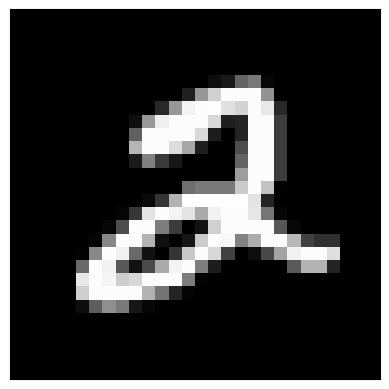

In [10]:
image, label = next(dataiter)

plt.xticks([])
plt.yticks([])
plt.imshow(image[0,:,:], cmap="gray");

In [11]:
# Create (i, j) -> color intensity dataset 

X = []
Y = []

for i in range(28):
    for j in range(28):
        X.append([i, j])
        Y.append([image[0, i, j]])

X = torch.tensor(X, dtype=torch.float32)
Y = torch.tensor(Y, dtype=torch.float32)

# X_min, X_max = X.min(), X.max()
X_mean, X_std = X.mean(axis=0), X.std(axis=0)
Y_mean, Y_std = Y.mean(axis=0), Y.std(axis=0)

# X = (X-X_min)/(X_max-X_min)
X = (X-X_mean)/X_std
Y = (Y-Y_mean)/Y_std

dataset = TensorDataset(X, Y)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)

In [12]:
def decode(i, j, model):
    idx = torch.tensor([i, j], dtype=torch.float32)
    x = (idx-X_mean)/X_std
    with torch.no_grad():
        y = model(x)
        y = y * Y_std + Y_mean
    y = torch.clip(y, -1, 1)
    y = y.item()
    return y

#### **Model 1**

A wide model, with ReLU activation. 

513 total parameters


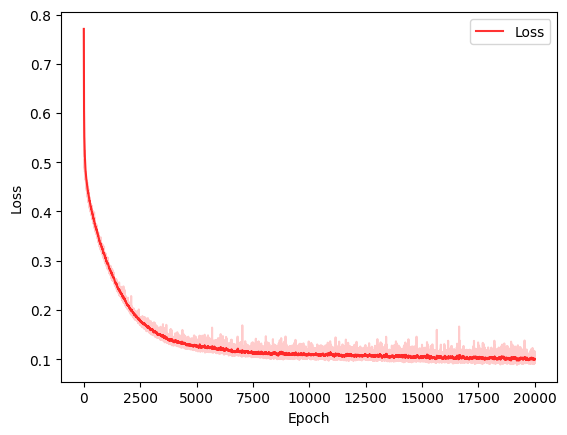

In [13]:
# Model

class Model1(torch.nn.Module):
    def __init__(self, n_hidden):
        super(Model1, self).__init__()
        self.linear1 = torch.nn.Linear(2, n_hidden)
        self.relu = torch.nn.ReLU()
        self.linear2 = torch.nn.Linear(n_hidden, 1)
        # How many parameters? 
        n_param = sum(prod(param.data.shape) for param in self.parameters())
        print(n_param, "total parameters")
    def forward(self, x):
        x = self.linear1(x)
        x = self.relu(x)
        x = self.linear2(x)
        return x

model1 = Model1(n_hidden=128)

loss_fn = torch.nn.MSELoss()
optimizer = torch.optim.SGD(model1.parameters(), lr=0.001, momentum=0.9)
EPOCHS = 20000

model1.train(True)
loss_history = []
# For each epoch: 
for epoch in range(EPOCHS):
    # For each batch:
    avg_loss = 0
    for inputs, labels in dataloader:
        optimizer.zero_grad()
        outputs = model1(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        optimizer.step()
        avg_loss += loss.item()
    avg_loss /= BATCH_SIZE 
    loss_history.append(avg_loss)

plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.plot(loss_history, color="red", alpha=0.2)  # Actual loss 
plt.plot(pd.Series(loss_history).ewm(alpha=0.05).mean(), color="red", alpha=0.8, label="Loss")  # Mov Avg 
plt.legend();

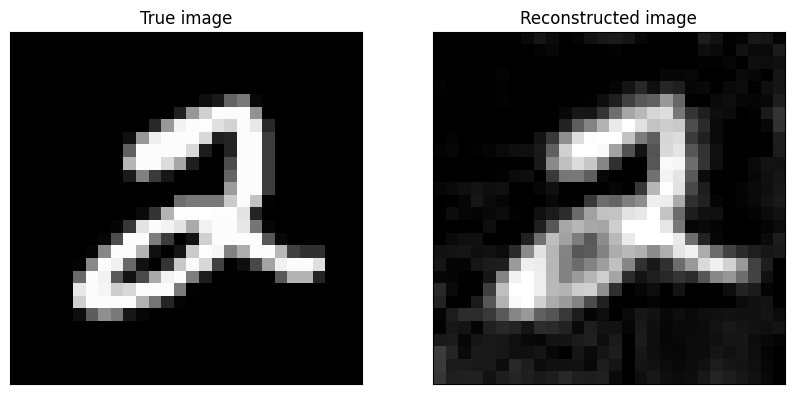

In [14]:
reconstructed_image = np.empty((28, 28))
for i in range(28):
    for j in range(28):
        reconstructed_image[i, j] = decode(i, j, model1)

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 5))

ax1.set_title("True image")
ax1.set_xticks([])
ax1.set_yticks([])
ax1.imshow(image[0,:,:], cmap="gray")

ax2.set_title("Reconstructed image")
ax2.set_xticks([])
ax2.set_yticks([])
ax2.imshow(reconstructed_image, cmap="gray");

In [ ]:
# The model is continuous!! 
# Let's predict the color intensity for positions in between pixels!! 

def reconstruct(size, model):
    reconstructed_image = np.empty((size, size))
    for _i, i in enumerate(np.linspace(0, 28, size)):
        for _j, j in enumerate(np.linspace(0, 28, size)):
            reconstructed_image[_i, _j] = decode(i, j, model)
    return reconstructed_image

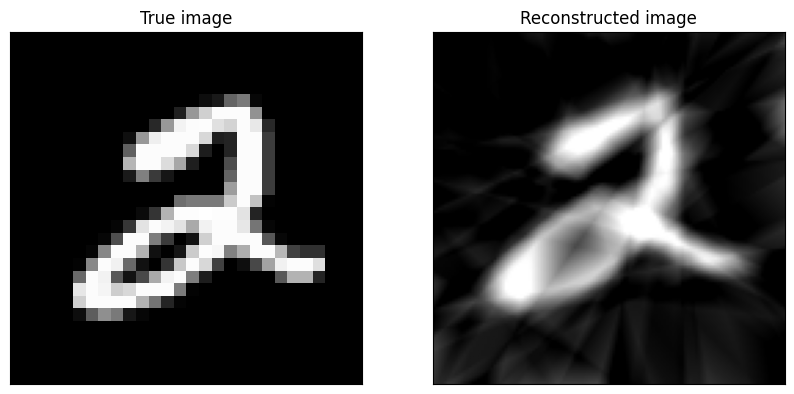

In [21]:
reconstructed_image = reconstruct(size, model1)

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 5))

ax1.set_title("True image")
ax1.set_xticks([])
ax1.set_yticks([])
ax1.imshow(image[0,:,:], cmap="gray")

ax2.set_title("Reconstructed image")
ax2.set_xticks([])
ax2.set_yticks([])
ax2.imshow(reconstructed_image, cmap="gray");

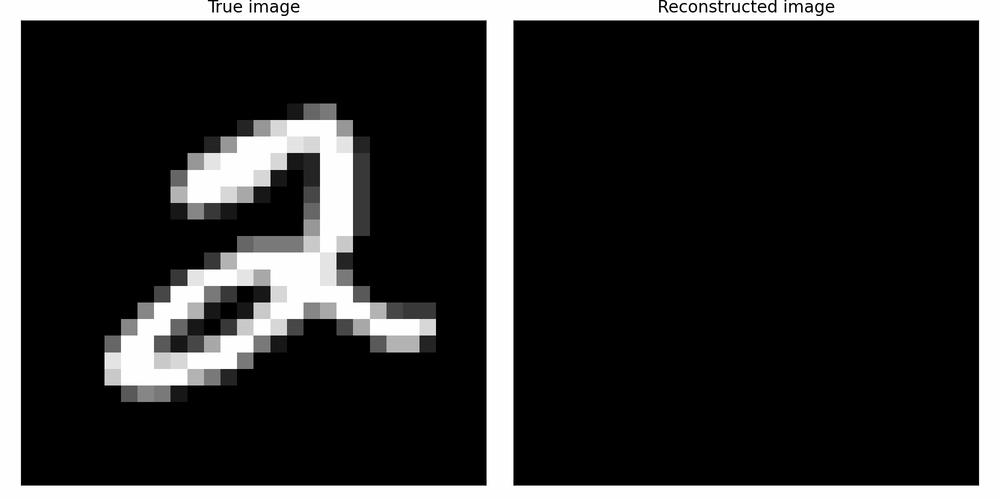

In [36]:
# Let's turn this into a gif as we increase the size from 1 to, say, 256
# Just for fun 

images = []

for size in range(1, 128+1):
    reconstructed_image = reconstruct(size, model1)
    
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 5))
    
    ax1.set_title("True image")
    ax1.set_xticks([])
    ax1.set_yticks([])
    ax1.imshow(image[0,:,:], cmap="gray")
    
    ax2.set_title("Reconstructed image")
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax2.imshow(reconstructed_image, cmap="gray")
    
    plt.tight_layout()
    plt.savefig(f"figures/{size}.png", dpi=200)
    plt.close() 
    images.append(imageio.v2.imread(f"figures/{size}.png"))
    os.remove(f"figures/{size}.png")

# GIF: 
imageio.mimsave("figure.gif", images)
Image(filename="figure.gif", width=800)

#### **Model 2**

A wide model, with Tanh activation. 

33 total parameters


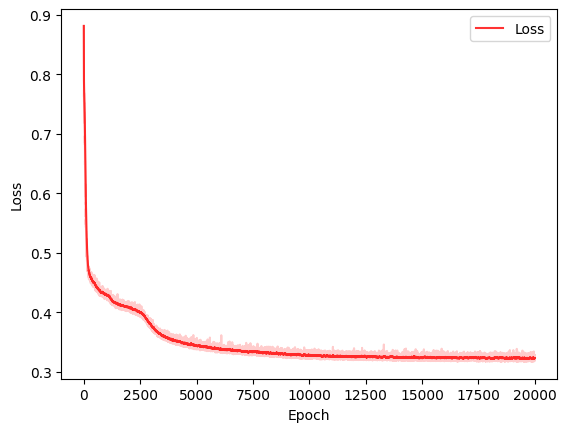

In [58]:
# Model

class Model2(torch.nn.Module):
    def __init__(self, n_hidden):
        super(Model2, self).__init__()
        self.linear1 = torch.nn.Linear(2, n_hidden)
        self.tanh = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(n_hidden, 1)
        # How many parameters? 
        n_param = sum(prod(param.data.shape) for param in self.parameters())
        print(n_param, "total parameters")
    def forward(self, x):
        x = self.linear1(x)
        x = self.tanh(x)
        x = self.linear2(x)
        return x

model2 = Model2(n_hidden=8)

loss_fn = torch.nn.MSELoss()
optimizer = torch.optim.SGD(model2.parameters(), lr=0.001, momentum=0.9)
EPOCHS = 20000

model2.train(True)
loss_history = []
# For each epoch: 
for epoch in range(EPOCHS):
    # For each batch:
    avg_loss = 0
    for inputs, labels in dataloader:
        optimizer.zero_grad()
        outputs = model2(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        optimizer.step()
        avg_loss += loss.item()
    avg_loss /= BATCH_SIZE 
    loss_history.append(avg_loss)

plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.plot(loss_history, color="red", alpha=0.2)  # Actual loss 
plt.plot(pd.Series(loss_history).ewm(alpha=0.05).mean(), color="red", alpha=0.8, label="Loss")  # Mov Avg 
plt.legend();

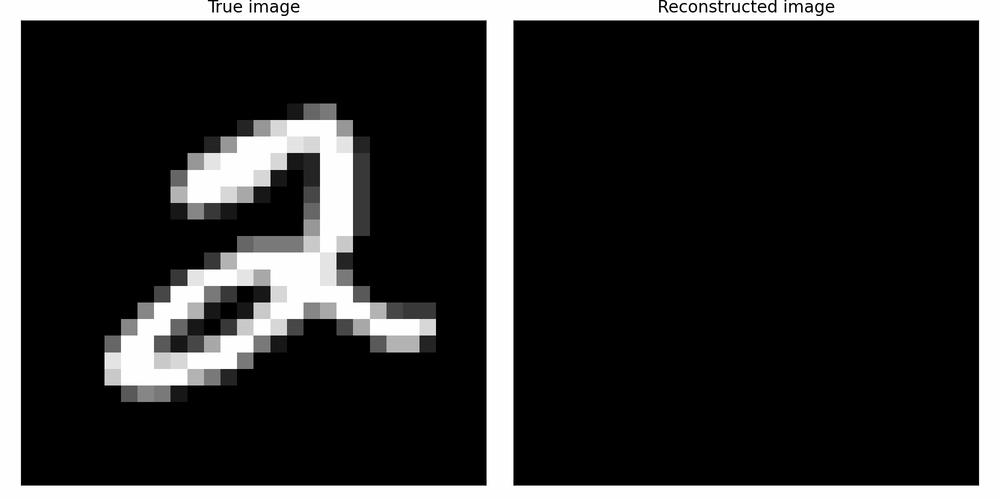

In [59]:
images = []

for size in range(1, 128+1):
    reconstructed_image = reconstruct(size, model2)
    
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 5))
    
    ax1.set_title("True image")
    ax1.set_xticks([])
    ax1.set_yticks([])
    ax1.imshow(image[0,:,:], cmap="gray")
    
    ax2.set_title("Reconstructed image")
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax2.imshow(reconstructed_image, cmap="gray")
    
    plt.tight_layout()
    plt.savefig(f"figures/{size}.png", dpi=200)
    plt.close() 
    images.append(imageio.v2.imread(f"figures/{size}.png"))
    os.remove(f"figures/{size}.png")

# GIF: 
imageio.mimsave("figure.gif", images)
Image(filename="figure.gif", width=800)

#### **Model 3**

A deep model. 

573 total parameters


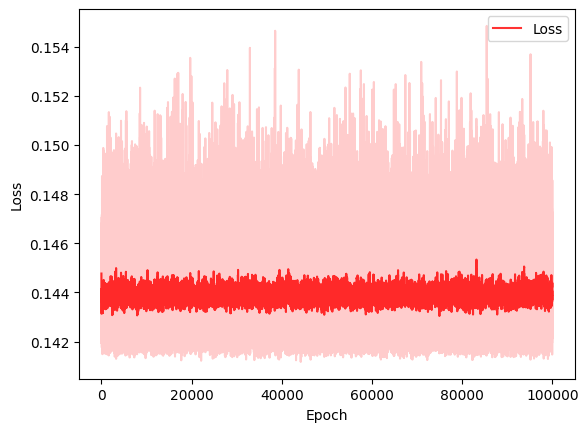

In [296]:
# Model

class Model3(torch.nn.Module):
    def __init__(self, n_hidden):
        super(Model3, self).__init__()
        self.linear1 = torch.nn.Linear(2, n_hidden)
        self.relu = torch.nn.ReLU()
        
        self.middle1 = torch.nn.Linear(n_hidden, n_hidden)
        self.relu1 = torch.nn.ReLU()
        self.middle2 = torch.nn.Linear(n_hidden, n_hidden)
        self.relu2 = torch.nn.ReLU()
        self.middle3 = torch.nn.Linear(n_hidden, n_hidden)
        self.relu3 = torch.nn.ReLU()
        self.middle4 = torch.nn.Linear(n_hidden, n_hidden)
        self.relu4 = torch.nn.ReLU()
        
        self.final = torch.nn.Linear(n_hidden, 1)
        # How many parameters? 
        n_param = sum(prod(param.data.shape) for param in self.parameters())
        print(n_param, "total parameters")
    def forward(self, x):
        x = self.linear1(x)
        x = self.relu(x)

        x = self.middle1(x)
        x = self.relu1(x)
        x = self.middle2(x)
        x = self.relu2(x)
        x = self.middle3(x)
        x = self.relu3(x)
        x = self.middle4(x)
        x = self.relu4(x)
        
        x = self.final(x)
        return x

model3 = Model3(n_hidden=11)

loss_fn = torch.nn.MSELoss()
optimizer = torch.optim.SGD(model3.parameters(), lr=0.001, momentum=0.9)
EPOCHS = 100000

model3.train(True)
loss_history = []
# For each epoch: 
for epoch in range(EPOCHS):
    # For each batch:
    avg_loss = 0
    for inputs, labels in dataloader:
        optimizer.zero_grad()
        outputs = model1(inputs)
        loss = loss_fn(outputs, labels)
        loss.backward()
        optimizer.step()
        avg_loss += loss.item()
    avg_loss /= BATCH_SIZE 
    loss_history.append(avg_loss)

plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.plot(loss_history, color="red", alpha=0.2)  # Actual loss 
plt.plot(pd.Series(loss_history).ewm(alpha=0.05).mean(), color="red", alpha=0.8, label="Loss")  # Mov Avg 
plt.legend();

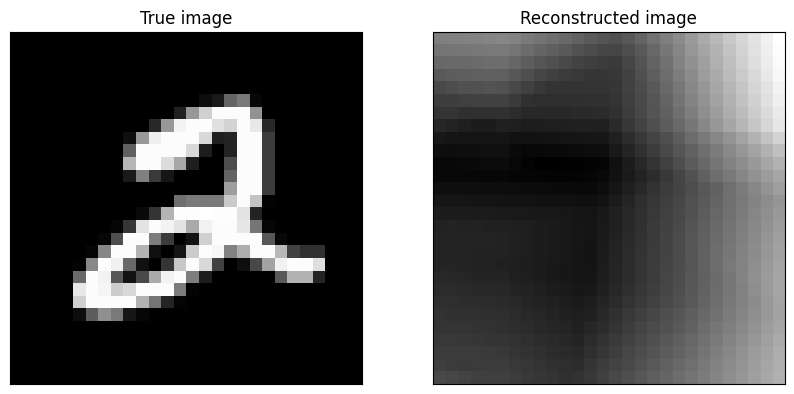

In [297]:
reconstructed_image = np.empty((28, 28))

for i in range(28):
    for j in range(28):
        reconstructed_image[i, j] = decode(i, j, model3)

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 5))

ax1.set_title("True image")
ax1.set_xticks([])
ax1.set_yticks([])
ax1.imshow(image[0,:,:], cmap="gray")

ax2.set_title("Reconstructed image")
ax2.set_xticks([])
ax2.set_yticks([])
ax2.imshow(reconstructed_image, cmap="gray");